In [1]:
using Random
Random.seed!(4649373)

using Distributions
using QuadGK
using Roots
using StatsPlots
default(fmt=:png)

function winningrate(
        distx::ContinuousUnivariateDistribution,
        disty::ContinuousUnivariateDistribution
    )
    quadgk(y -> cdf(distx, y)*pdf(disty, y), extrema(disty)...)[1]
end

function tieshift(
        distx::ContinuousUnivariateDistribution,
        disty::ContinuousUnivariateDistribution;
        p = 1/2
    )
    find_zero(0.0) do a
        winningrate(distx + a, disty) - p
    end
end

@show distx = Exponential(1)
@show disty = Exponential(1.5)
@show winningrate(distx, disty)
println()
@show tiesh = tieshift(distx, disty)
@show mediansh = median(disty) - median(distx)
@show meansh = mean(disty) - mean(distx)
println()
@show winningrate(distx + tiesh, disty)
@show winningrate(distx + mediansh, disty)
@show winningrate(distx + meansh, disty)
println()
@show median(distx + tiesh)
@show median(distx + mediansh)
@show median(distx + meansh)
@show median(disty)
println()
@show mean(distx + tiesh)
@show mean(distx + mediansh)
@show mean(distx + meansh)
@show mean(disty)
;

distx = Exponential(1) = Exponential{Float64}(θ=1.0)
disty = Exponential(1.5) = Exponential{Float64}(θ=1.5)
winningrate(distx, disty) = 0.6000000000000003

tiesh = tieshift(distx, disty) = 0.27348233139104033
mediansh = median(disty) - median(distx) = 0.3465735902799726
meansh = mean(disty) - mean(distx) = 0.5

winningrate(distx + tiesh, disty) = 0.5
winningrate(distx + mediansh, disty) = 0.47622031634305906
winningrate(distx + meansh, disty) = 0.4299187894696709

median(distx + tiesh) = 0.9666295119509856
median(distx + mediansh) = 1.0397207708399179
median(distx + meansh) = 1.1931471805599454
median(disty) = 1.0397207708399179

mean(distx + tiesh) = 1.2734823313910404
mean(distx + mediansh) = 1.3465735902799727
mean(distx + meansh) = 1.5
mean(disty) = 1.5


In [2]:
using Distributions

@doc raw"""
    brunner_munzel_test(X, Y; p = 1/2)

この函数は数値のベクトルのデータ `X`, `Y` について, Brunner-Munzel検定関係の統計量達を計算する. 詳細は以下の通り.

函数 $H(x, y)$ と $\hat{p}$, $H^x_i$, $H^y_j$, $\bar{H}^x$, $\bar{H}^y$ を次のように定める:

```math
\begin{aligned}
&
m = \mathrm{length}(X), \quad
n = \mathrm{length}(Y), \quad
x_i = X[i], \quad
y_j = Y[j],
\\ &
\hat{p} = \frac{1}{mn}\sum_{i=1}^m \sum_{j=1}^n H(x_i, y_j),
\\ &
H(x, y) = \begin{cases} 1 & (x < y) \\ 1/2 & (x = y) \\ 0 & (x > y), \end{cases}
\\ &
H^x_i = \sum_{j=1}^n H(y_j, x_i), \quad
H^y_j = \sum_{i=1}^m H(x_i, y_j),
\\ &
\bar{H}^x = \frac{1}{m} \sum_{i=1}^m H^x_i = n - n\hat{p}, \quad
\bar{H}^y = \frac{1}{n} \sum_{j=1}^n H^y_j = m\hat{p}.
\end{aligned}
```

この函数は以下達の named tuple で返す:

```math
\begin{aligned}
&
\mathrm{phat} = 
\hat{p} = \frac{\bar{H}^y - \bar{H}^x + n}{m + n},
\\ &
\mathrm{sx2} =
\hat{\sigma}_x^2 = \frac{1}{n^2}\frac{1}{m-1}\sum_{i=1}^m (H^x_i - \bar{H}^x)^2,
\\ &
\mathrm{sy2} =
\hat{\sigma}_y^2 = \frac{1}{m^2}\frac{1}{n-1}\sum_{j=1}^n (H^y_j - \bar{H}^y)^2,
\\ &
\mathrm{sehat} = 
\widehat{\mathrm{se}} = \sqrt{\frac{\hat{\sigma}_x^2}{m} + \frac{\hat{\sigma}_y^2}{n}}, 
\\ &
\mathrm{tvalue} = t = \frac{\hat{p} - p}{\widehat{\mathrm{se}}},
\\ &
\mathrm{df} =
\nu = 
\frac
{\left(\hat{\sigma}_x^2/m + \hat{\sigma}_y^2/n\right)^2}
{
\dfrac{\left(\hat{\sigma}_x^2/m\right)^2}{m-1} +
\dfrac{\left(\hat{\sigma}_y^2/n\right)^2}{n-1}
},
\\ &
\mathrm{pvalue} =
2\mathrm{ccdf}(\mathrm{TDist}(\nu), |t|),
\\ &
\mathrm{p} = p.
\end{aligned}
```
"""
function brunner_munzel_test(X, Y; p=1/2)
    m, n = length(X), length(Y)
    phat = mean((x < y) + (x == y)/2 for x in X, y in Y)
    Hbarx = n*(1 - phat)
    Hbary = m*phat
    sx2 = 1/n^2 * 1/(m-1) * sum(x -> (sum((y < x) + (y == x)/2 for y in Y) - Hbarx)^2, X)
    sy2 = 1/m^2 * 1/(n-1) * sum(y -> (sum((x < y) + (x == y)/2 for x in X) - Hbary)^2, Y)
    sehat = √(sx2/m + sy2/n)
    tvalue = (phat - p)/sehat
    df = (sx2/m + sy2/n)^2 / ((sx2/m)^2/(m-1) + (sy2/n)^2/(n-1))
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; phat, sehat, tvalue, df, pvalue, p)
end

@doc raw"""
    pvalue_brunner_munzel_test(X, Y; p = 1/2)

この函数はBrunner-Munzel検定のP値 `pvalue` を返す.
"""
pvalue_brunner_munzel_test(X, Y; p=1/2) = brunner_munzel_test(X, Y; p).pvalue

using RCall
@rimport lawstat
X = rand(100)
Y = rand(100)
pvalue_brunner_munzel_test(X, Y), rcopy(lawstat.brunner_munzel_test(X, Y))[:p_value]

(0.10237071161776065, 0.10237071161776079)

In [3]:
@doc brunner_munzel_test

```
brunner_munzel_test(X, Y; p = 1/2)
```

この函数は数値のベクトルのデータ `X`, `Y` について, Brunner-Munzel検定関係の統計量達を計算する. 詳細は以下の通り.

函数 $H(x, y)$ と $\hat{p}$, $H^x_i$, $H^y_j$, $\bar{H}^x$, $\bar{H}^y$ を次のように定める:

$$
\begin{aligned}
&
m = \mathrm{length}(X), \quad
n = \mathrm{length}(Y), \quad
x_i = X[i], \quad
y_j = Y[j],
\\ &
\hat{p} = \frac{1}{mn}\sum_{i=1}^m \sum_{j=1}^n H(x_i, y_j),
\\ &
H(x, y) = \begin{cases} 1 & (x < y) \\ 1/2 & (x = y) \\ 0 & (x > y), \end{cases}
\\ &
H^x_i = \sum_{j=1}^n H(y_j, x_i), \quad
H^y_j = \sum_{i=1}^m H(x_i, y_j),
\\ &
\bar{H}^x = \frac{1}{m} \sum_{i=1}^m H^x_i = n - n\hat{p}, \quad
\bar{H}^y = \frac{1}{n} \sum_{j=1}^n H^y_j = m\hat{p}.
\end{aligned}
$$

この函数は以下達の named tuple で返す:

$$
\begin{aligned}
&
\mathrm{phat} = 
\hat{p} = \frac{\bar{H}^y - \bar{H}^x + n}{m + n},
\\ &
\mathrm{sx2} =
\hat{\sigma}_x^2 = \frac{1}{n^2}\frac{1}{m-1}\sum_{i=1}^m (H^x_i - \bar{H}^x)^2,
\\ &
\mathrm{sy2} =
\hat{\sigma}_y^2 = \frac{1}{m^2}\frac{1}{n-1}\sum_{j=1}^n (H^y_j - \bar{H}^y)^2,
\\ &
\mathrm{sehat} = 
\widehat{\mathrm{se}} = \sqrt{\frac{\hat{\sigma}_x^2}{m} + \frac{\hat{\sigma}_y^2}{n}}, 
\\ &
\mathrm{tvalue} = t = \frac{\hat{p} - p}{\widehat{\mathrm{se}}},
\\ &
\mathrm{df} =
\nu = 
\frac
{\left(\hat{\sigma}_x^2/m + \hat{\sigma}_y^2/n\right)^2}
{
\dfrac{\left(\hat{\sigma}_x^2/m\right)^2}{m-1} +
\dfrac{\left(\hat{\sigma}_y^2/n\right)^2}{n-1}
},
\\ &
\mathrm{pvalue} =
2\mathrm{ccdf}(\mathrm{TDist}(\nu), |t|),
\\ &
\mathrm{p} = p.
\end{aligned}
$$


In [4]:
function mann_whitney_u_test(X, Y; correct=true)
    m, n = length(X), length(Y)
    phat = mean((x < y) + (x == y)/2 for x in X, y in Y)
    sehat = √((m+n+1)/(12m*n))
    zvalue = (phat - 1/2)/sehat
    correction = correct/(2m*n*sehat)
    pvalue = 2ccdf(Normal(), max(0, abs(zvalue) - correction))
    (; phat, sehat, zvalue, pvalue)
end

pvalue_mann_whitney_u_test(X, Y; correct=true) = mann_whitney_u_test(X, Y; correct).pvalue

using HypothesisTests
X = randn(100)
Y = randn(100)
pvalue_mann_whitney_u_test(X, Y), pvalue(ApproximateMannWhitneyUTest(X, Y))

(0.04990007292443201, 0.04990007292443193)

In [5]:
function student_t_test(X, Y; μ = 0.0)
    m, X̄, SX2 = length(X), mean(X), var(X)
    n, Ȳ, SY2 = length(Y), mean(Y), var(Y)
    S2 = ((m-1)*SX2 + (n-1)*SY2) / (m+n-2)
    sehat2 = S2 * (1/m + 1/n)
    tvalue = (X̄ - Ȳ - μ) / √sehat2
    df = m + n - 2
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; pvalue, tvalue, sehat2, df)
end

pvalue_student_t_test(X, Y; μ = 0.0) = student_t_test(X, Y; μ).pvalue

using HypothesisTests
X = randn(100)
Y = randn(100)
pvalue_student_t_test(X, Y), pvalue(EqualVarianceTTest(X, Y))

(0.4389806931272048, 0.4389806931272048)

In [6]:
function welch_t_test(X, Y; μ = 0.0)
    m, X̄, SX2 = length(X), mean(X), var(X)
    n, Ȳ, SY2 = length(Y), mean(Y), var(Y)
    sehat2 = SX2/m + SY2/n
    tvalue = (X̄ - Ȳ - μ) / √sehat2
    df = sehat2^2 / ((SX2/m)^2/(m-1) + (SY2/n)^2/(n-1))
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; pvalue, tvalue, sehat2, df)
end

pvalue_welch_t_test(X, Y; μ = 0.0) =welch_t_test(X, Y; μ).pvalue

using HypothesisTests
X = randn(100)
Y = randn(100)
pvalue_welch_t_test(X, Y), pvalue(UnequalVarianceTTest(X, Y))

(0.7219945156946428, 0.7219945156946428)

In [7]:
"""
gammadist(σ, β)

returns the gamma distribution with standard deviation `σ` and skewness `β`.
"""
gammadist(σ, β) = Gamma(4/β^2, β*σ/2)

gam = gammadist.(1:5, 2:2:10)
std.(gam), skewness.(gam), kurtosis.(gam)

([1.0, 2.0, 3.0, 4.0, 5.0], [2.0, 4.0, 6.0, 8.0, 10.0], [6.0, 24.0, 54.0, 96.0, 150.0])

In [8]:
@doc gammadist

gammadist(σ, β)

returns the gamma distribution with standard deviation `σ` and skewness `β`.


In [9]:
"""
inversegammadist(σ, β)

returns the inverse gamma distribution with standard deviation `σ` and skewness `β`.
"""
function inversegammadist(σ, β)
    γ = 1/β
    α = 3 + 8γ^2 + 4γ * √(1 + 4γ^2)
    θ = σ * (α - 1) * √(α - 2)
    InverseGamma(α, θ)
end

igam = inversegammadist.(1:5, 2:2:10)
std.(igam), skewness.(igam), kurtosis.(igam)

([0.9999999999999999, 2.0, 3.0, 3.9999999999999996, 5.0], [2.0, 4.0, 6.0, 7.999999999999998, 10.0], [9.134446499564898, 72.54101966249682, NaN, NaN, NaN])

In [10]:
@doc inversegammadist

inversegammadist(σ, β)

returns the inverse gamma distribution with standard deviation `σ` and skewness `β`.


In [11]:
function prc(s, x, α)
    if x < α/2
        printstyled(s, x; color=:blue, bold=true)
    elseif x < α/1.3
        printstyled(s, x; color=:blue)
    elseif x < 1.3α
        print(s, x)
    elseif x < 2α
        printstyled(s, x; color=:red)
    else
        printstyled(s, x; color=:red, bold=true)
    end
    println()
end

for k in 0.01:0.01:0.11
    prc("hoge: ", k, 0.05)
end

hoge: 0.01
hoge: 0.02
hoge: 0.03
hoge: 0.04
hoge: 0.05
hoge: 0.06
hoge: 0.07
hoge: 0.08
hoge: 0.09
hoge: 0.1
hoge: 0.11



  0.681569 seconds (4.58 M allocations: 176.473 MiB, 2.37% gc time, 631.51% compilation time)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 0.0
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 0.0

true α-error rate for α = 0.05
  Welch t-test:        0.08538
  Student t-test:      0.17146
  Brunner-Munzel test: 0.05157
  WMW test:            0.06809



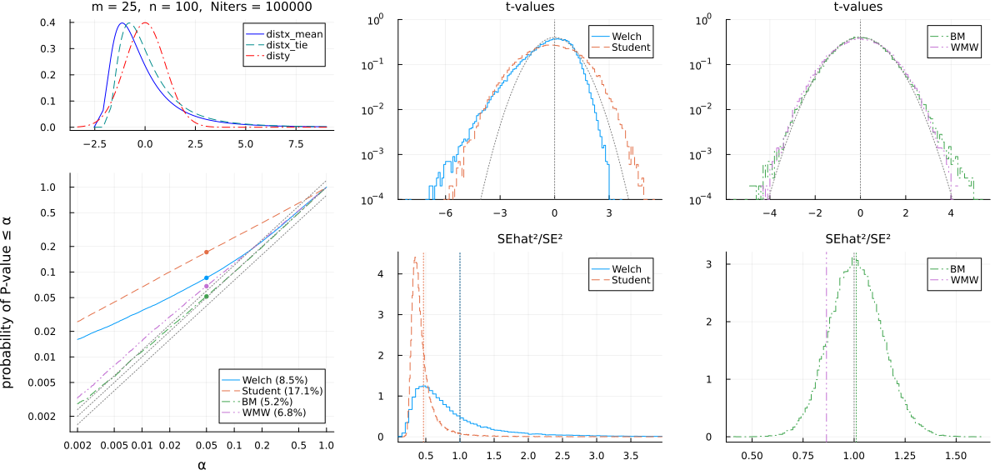

In [12]:
undefvector(T::Type, m) = Vector{T}(undef, m)
undefvector(m) = undefvector(Float64, m)
ECDF(A, x) = count(≤(x), A)/length(A)
rd(x) = round(x; digits=1)

function plot_sim(;
        distx = inversegammadist(2, 5),
        disty = Normal(0, 1),
        xlim = :auto,
        ylim = :auto,
        m = 25,
        n = 100,
        L = 10^6,
        shifttype = :auto,
        α = 0.05,
        legend = :bottomright,
        correct = true,
        verbose = false,
    )
    
    tiesh = tieshift(distx, disty)
    mediansh = median(disty) - median(distx)
    meansh = mean(disty) - mean(distx)
    if verbose
        @show tiesh mediansh meansh
    end
    println()
    
    distx_tie = distx + tiesh
    distx_median = distx + mediansh
    distx_mean = distx + meansh
    if shifttype == :tie
        distx = distx_tie
    elseif shifttype == :median
        distx = distx_median
    elseif shifttype == :mean || shifttype == :auto
        distx = distx_mean
    end
    if verbose
        @show shifttype
        @show distx
        @show winningrate(distx, disty)
        @show median(distx) median(disty)
        @show mean(distx) mean(disty)
        println()
    end

    if xlim == :auto
        a = minimum(quantile.((distx_mean, distx_median, distx_tie, disty), 0.01))
        b = maximum(quantile.((distx_mean, distx_median, distx_tie, disty), 0.99))
        l = b - a
        a = a - l/10
        b = b + l/10
    else
        a, b = xlim
    end
    P1 = plot()
    if shifttype == :auto
        plot!(distx_mean, a, b; label="distx_mean", c=:blue)
        plot!(distx_tie, a, b; label="distx_tie", c=:darkcyan, ls=:dash)
    else
        plot!(distx, a, b; label="distx", c=:blue)
    end
    plot!(disty, a, b; label="disty", ls=:dashdot, c=:red)
    plot!(; ylim)
    title!("m = $m,  n = $n,  Niters = $L"; titlefontsize=10)

    pval_we = undefvector(L)
    pval_st = undefvector(L)
    tval_we = undefvector(L)
    tval_st = undefvector(L)
    sehat2_we = undefvector(L)
    sehat2_st = undefvector(L)
    
    pval_bm = undefvector(L)
    pval_mw = undefvector(L)
    tval_bm = undefvector(L)
    tval_mw = undefvector(L)
    sehat2_bm = undefvector(L)
    sehat2_mw = undefvector(L)
    phat = undefvector(L)

    nth = Threads.nthreads()
    Xtmp = [undefvector(m) for _ in 1:nth]
    Ytmp = [undefvector(n) for _ in 1:nth]
    
    @time Threads.@threads for i in 1:L
        tid = Threads.threadid()
        X = rand!(distx, Xtmp[tid])
        Y = rand!(disty, Ytmp[tid])
        we = welch_t_test(X, Y)
        st = student_t_test(X, Y)
        pval_we[i], tval_we[i], sehat2_we[i] = we.pvalue, we.tvalue, we.sehat2
        pval_st[i], tval_st[i], sehat2_st[i] = st.pvalue, st.tvalue, st.sehat2
        if shifttype == :auto
            @. X = X - meansh + tiesh
        end
        bm = brunner_munzel_test(X, Y)
        mw = mann_whitney_u_test(X, Y; correct)
        pval_bm[i], tval_bm[i], sehat2_bm[i] = bm.pvalue, bm.tvalue, bm.sehat^2
        pval_mw[i], tval_mw[i], sehat2_mw[i] = mw.pvalue, mw.zvalue, mw.sehat^2
        phat[i] = bm.phat
    end
    println()
    @show std(distx) std(disty)
    @show skewness(distx) skewness(disty)
    @show kurtosis(distx) kurtosis(disty)
    println()
    
    e_we = ECDF(pval_we, α)
    e_st = ECDF(pval_st, α)
    e_bm = ECDF(pval_bm, α)
    e_mw = ECDF(pval_mw, α)
    println("true α-error rate for α = $α")
    prc("  Welch t-test:        ", e_we, α)
    prc("  Student t-test:      ", e_st, α)
    prc("  Brunner-Munzel test: ", e_bm, α)
    prc("  WMW test:            ", e_mw, α)
    println()

    _tick = [0.002, 0.005, 0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 1]
    xtick = ytick = (_tick, string.(_tick))

    αs = exp.(range(log(0.002), log(1), 1000))
    P2 = plot()
    plot!(αs, α -> ECDF(pval_we, α); label="Welch ($(rd(100e_we))%)", c=1)
    plot!(αs, α -> ECDF(pval_st, α); label="Student ($(rd(100e_st))%)", ls=:dash, c=2)
    plot!(αs, α -> ECDF(pval_bm, α); label="BM ($(rd(100e_bm))%)", ls=:dashdot, c=3)
    plot!(αs, α -> ECDF(pval_mw, α); label="WMW ($(rd(100e_mw))%)", ls=:dashdotdot, c=4)
    scatter!([α], [e_we]; ms=3, msc=:auto, label="", c=1)
    scatter!([α], [e_st]; ms=3, msc=:auto, label="", c=2)
    scatter!([α], [e_bm]; ms=3, msc=:auto, label="", c=3)
    scatter!([α], [e_mw]; ms=3, msc=:auto, label="", c=4)
    plot!(αs, identity; label="", ls=:dot, c=:gray)
    plot!(αs, x->0.8x; label="", ls=:dot, c=:gray)
    plot!(αs, x->1.2x; label="", ls=:dot, c=:gray)
    plot!(; xscale=:log10, yscale=:log10, xtick, ytick)
    plot!(; xguide="α", yguide="probability of P-value ≤ α")
    plot!(; legend)
    
    P3 = plot()
    stephist!(tval_we; norm=true, label="Welch")
    stephist!(tval_st; norm=true, label="Student", ls=:dash)
    plot!(Normal(), -5, 5; label="", ls=:dot, c=:gray)
    vline!([0.0]; label="", ls=:dot, c=:gray)
    plot!(; yscale=:log10, ylim=(1e-4, 1))
    title!("t-values"; titlefontsize=10)

    se2 = var(distx)/m + var(disty)/n
    if verbose
        @show (mean(sehat2_we)/se2, std(sehat2_we)/se2)
        @show (mean(sehat2_st)/se2, std(sehat2_st)/se2)
    end
    P4 = plot()
    stephist!(sehat2_we/se2; norm=true, label="Welch", c=1)
    vline!([mean(sehat2_we)/se2]; label="", ls=:dot, c=1)
    stephist!(sehat2_st/se2; norm=true, label="Student", ls=:dash, c=2)
    vline!([mean(sehat2_st)/se2]; label="", ls=:dot, c=2)
    plot!(; xlim = quantile.(([sehat2_we/se2; sehat2_st/se2],), (0.0, 0.99)))
    vline!([1.0]; label="", ls=:dot, c=:gray)
    title!("SEhat²/SE²"; titlefontsize=10)
    
    P5 = plot()
    stephist!(tval_bm; norm=true, label="BM", ls=:dashdot, c=3)
    stephist!(tval_mw; norm=true, label="WMW", ls=:dashdotdot, c=4)
    plot!(Normal(), -5, 5; label="", ls=:dot, c=:gray)
    vline!([0.0]; label="", ls=:dot, c=:gray)
    plot!(; yscale=:log10, ylim=(1e-4, 1))
    title!("t-values"; titlefontsize=10)

    se2 = var(phat)
    if verbose
        @show (mean(sehat2_bm)/se2, std(sehat2_bm)/se2)
        @show mean(sehat2_mw)/se2
    end
    P6 = plot()
    stephist!(sehat2_bm/se2; norm=true, label="BM", ls=:dashdot, c=3)
    vline!([mean(sehat2_bm)/se2]; label="", ls=:dot, c=3)
    vline!([mean(sehat2_mw)/se2]; label="WMW", ls=:dashdotdot, c=4)
    vline!([1.0]; label="", ls=:dot, c=:gray)
    title!("SEhat²/SE²"; titlefontsize=10)
    
    layout = @layout [[a{0.3h} ; b] [c; d] [e; f]]
    plot(P1, P2, P3, P4, P5, P6; size=(1200, 570), layout)
    plot!(leftmargin=4Plots.mm, bottommargin=4Plots.mm)
end

plot_sim(; L=10^5)


  2.413455 seconds (35.82 M allocations: 1.426 GiB, 3.36% gc time)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 0.0
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 0.0

true α-error rate for α = 0.05
  Welch t-test:        0.084873
  Student t-test:      0.170399
  Brunner-Munzel test: 0.220102
  WMW test:            0.281004



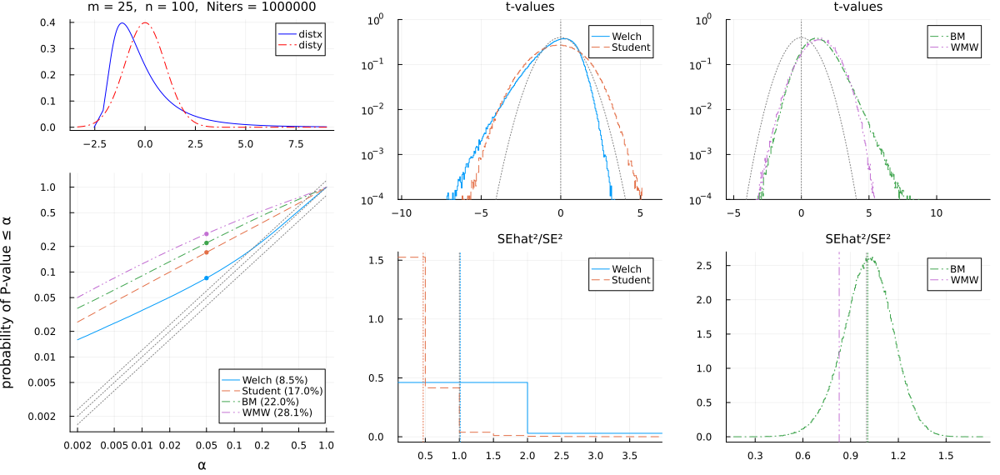

In [13]:
plot_sim(; shifttype=:mean)


  2.562507 seconds (35.82 M allocations: 1.426 GiB, 8.06% gc time)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 0.0
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 0.0

true α-error rate for α = 0.05
  Welch t-test:        0.07254
  Student t-test:      0.279795
  Brunner-Munzel test: 0.05159
  WMW test:            0.06748



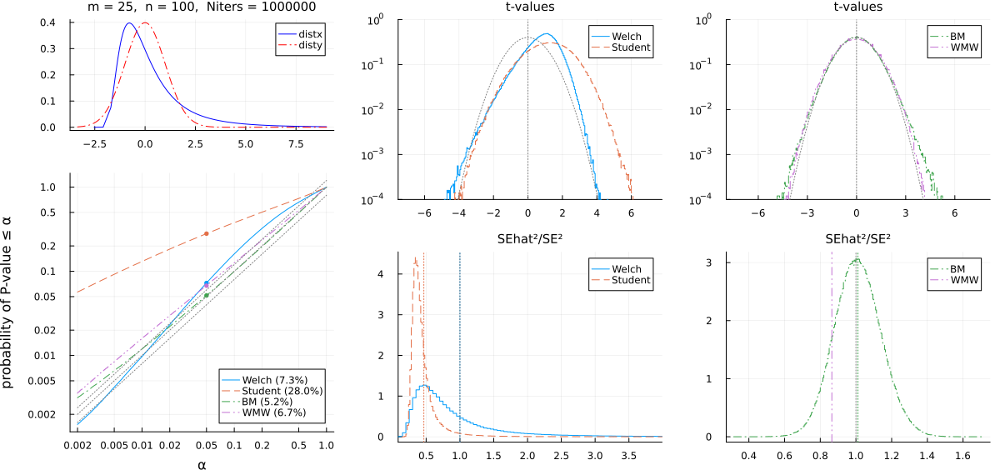

In [14]:
plot_sim(; shifttype=:tie)


  2.434250 seconds (36.59 M allocations: 1.645 GiB)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 0.0
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 0.0

true α-error rate for α = 0.05
  Welch t-test:        0.164214
  Student t-test:      0.443041
  Brunner-Munzel test: 0.086447
  WMW test:            0.107504



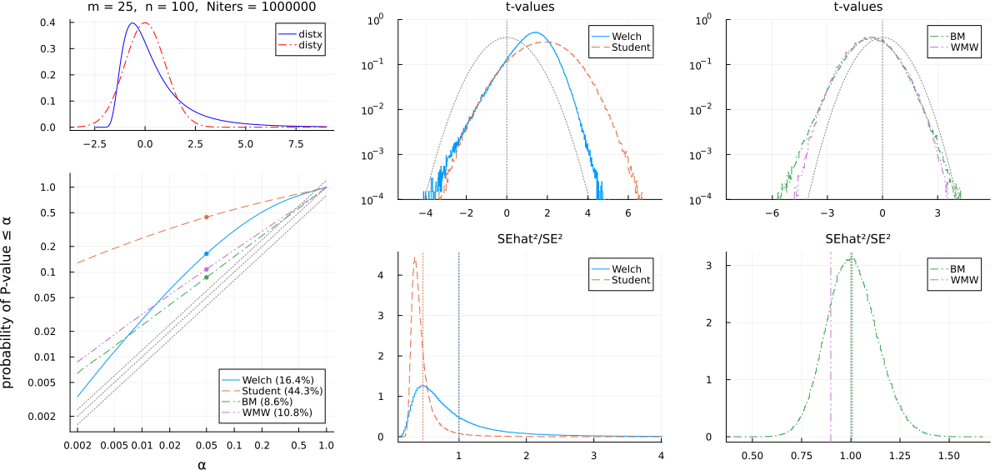

In [15]:
plot_sim(; shifttype=:median)


  3.041990 seconds (41.00 M allocations: 1.335 GiB, 19.10% compilation time)

std(distx) = 1.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.065267
  Student t-test:      0.048106
  Brunner-Munzel test: 0.051709
  WMW test:            0.048983



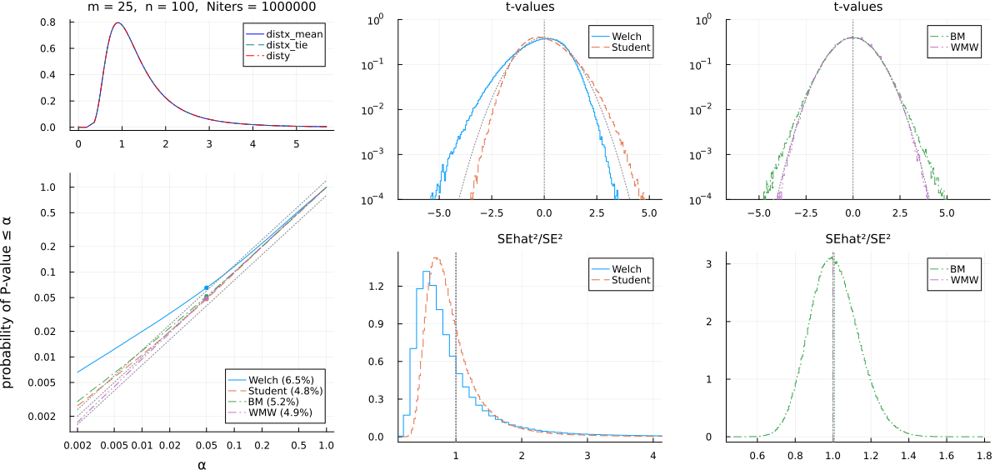

In [16]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=25, n=100)


  2.915631 seconds (4.09 M allocations: 136.402 MiB)

std(distx) = 1.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.05787
  Student t-test:      0.05008
  Brunner-Munzel test: 0.05117
  WMW test:            0.05075



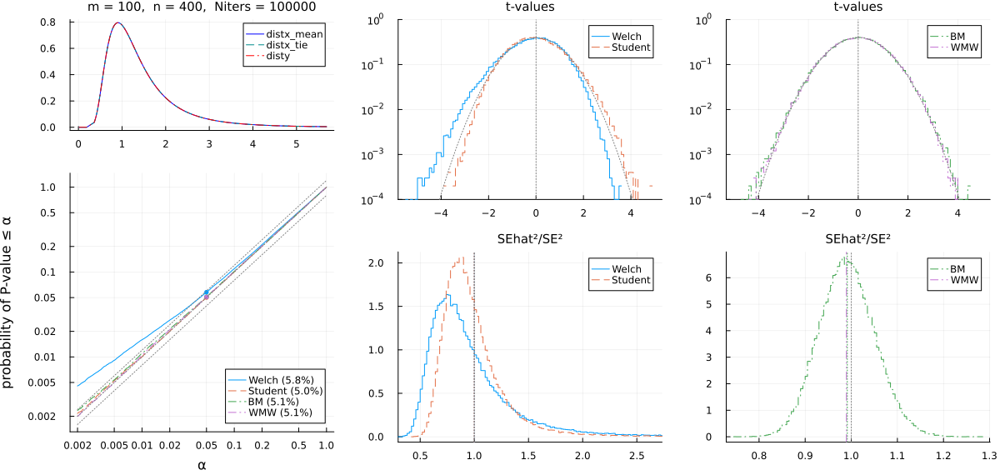

In [17]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=100, n=400, L=10^5)


  3.037802 seconds (41.07 M allocations: 1.364 GiB)

std(distx) = 1.2
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.071376
  Student t-test:      0.073464
  Brunner-Munzel test: 0.051706
  WMW test:            0.062582



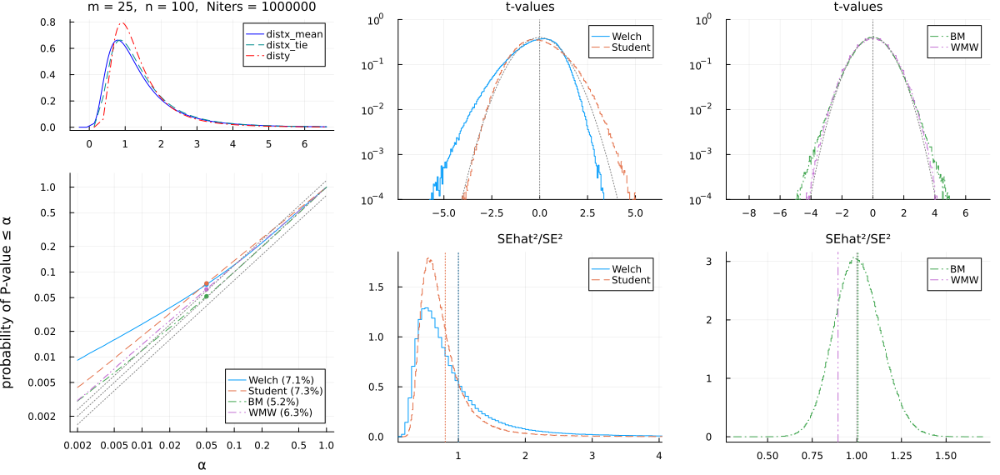

In [18]:
distx = inversegammadist(1.2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=25, n=100)


  3.385677 seconds (4.10 M allocations: 138.763 MiB)

std(distx) = 1.2
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.05849
  Student t-test:      0.07609
  Brunner-Munzel test: 0.04973
  WMW test:            0.06353



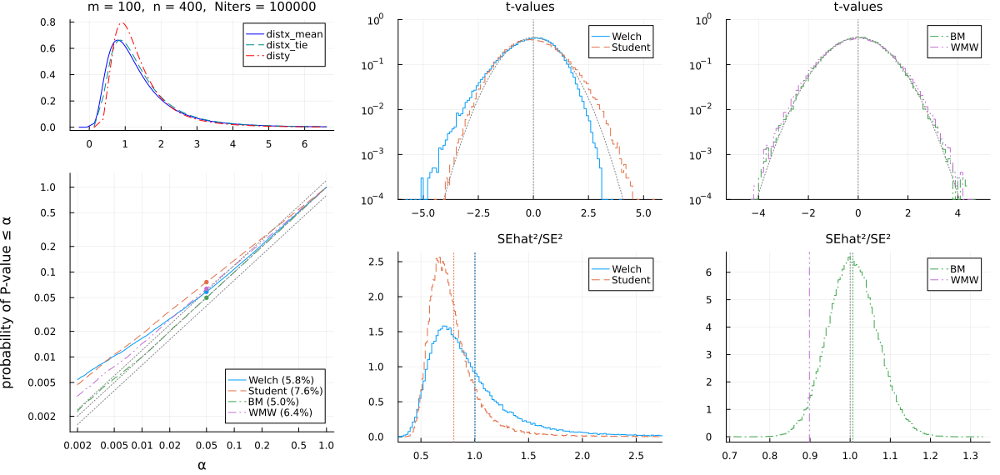

In [19]:
distx = inversegammadist(1.2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=100, n=400, L=10^5)


 41.482201 seconds (4.10 M allocations: 138.434 MiB)

std(distx) = 1.2
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.05253
  Student t-test:      0.07719
  Brunner-Munzel test: 0.05001
  WMW test:            0.06456



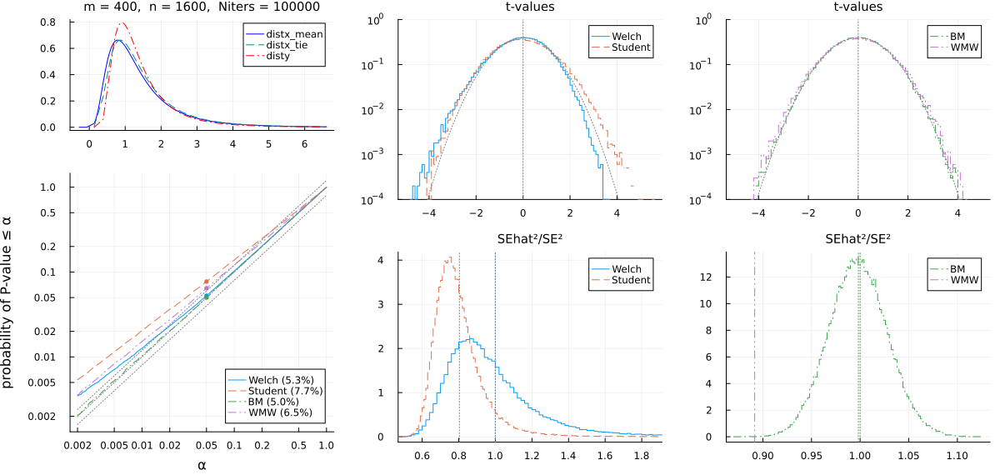

In [20]:
distx = inversegammadist(1.2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=400, n=1600, L=10^5)


  3.606445 seconds (41.34 M allocations: 1.438 GiB, 6.06% gc time)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.08378
  Student t-test:      0.180842
  Brunner-Munzel test: 0.051355
  WMW test:            0.103518



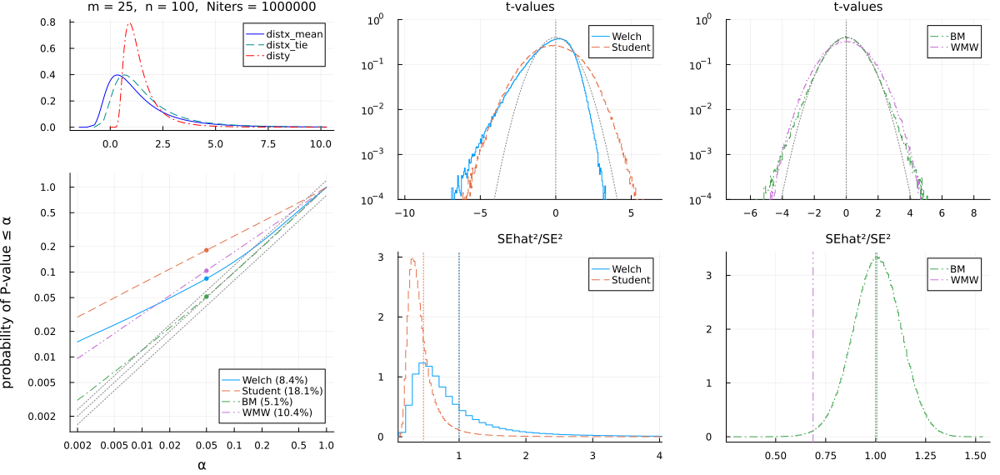

In [21]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=25, n=100)


  3.135300 seconds (40.85 M allocations: 1.300 GiB)

std(distx) = 1.0
std(disty) = 1.2
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.058233
  Student t-test:      0.031571
  Brunner-Munzel test: 0.051709
  WMW test:            0.037095



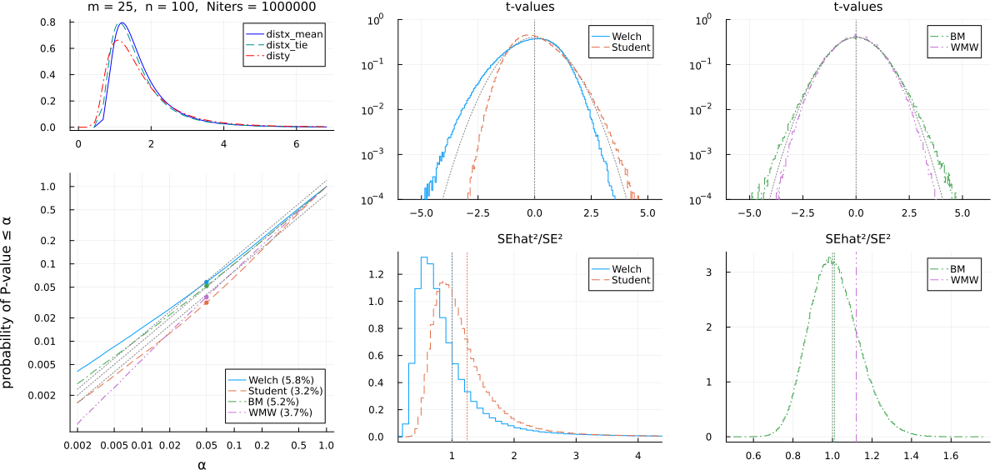

In [22]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1.2, 5)
plot_sim(; distx, disty, m=25, n=100)


  3.001282 seconds (40.72 M allocations: 1.264 GiB)

std(distx) = 1.0
std(disty) = 1.5
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.050247
  Student t-test:      0.020482
  Brunner-Munzel test: 0.051309
  WMW test:            0.02566



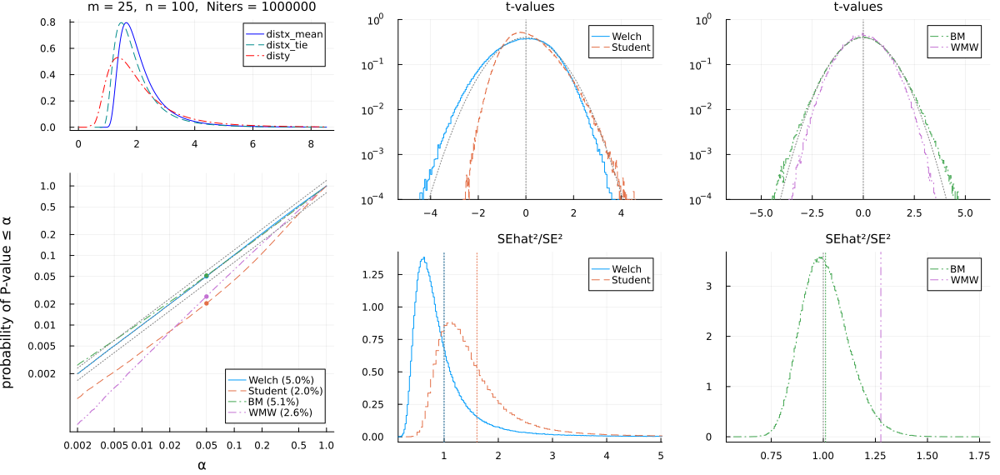

In [23]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1.5, 5)
plot_sim(; distx, disty, m=25, n=100)


  3.073170 seconds (37.88 M allocations: 2.008 GiB, 3.15% gc time, 2.54% compilation time)

std(distx) = 1.0
std(disty) = 1.5
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.823757
  Student t-test:      0.744358
  Brunner-Munzel test: 0.906601
  WMW test:            0.923764



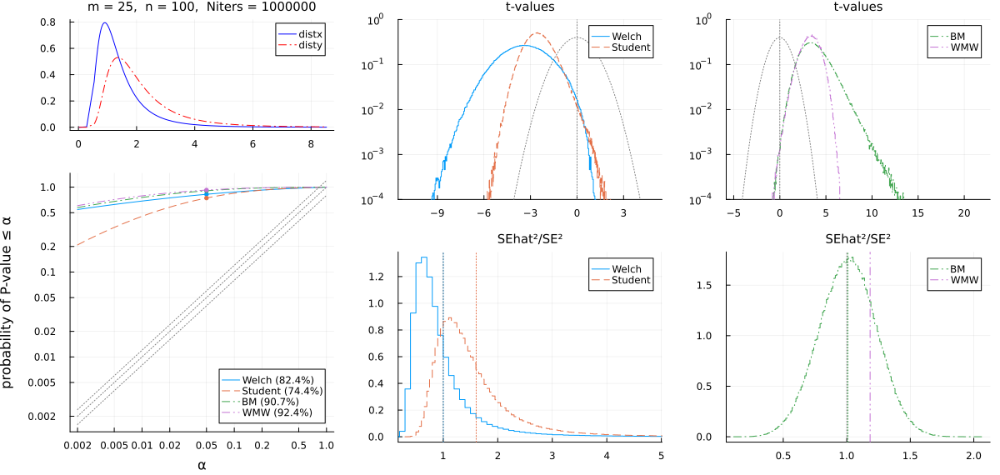

In [24]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1.5, 5)
plot_sim(; distx, disty, m=25, n=100, shifttype=:none)


  3.105033 seconds (40.99 M allocations: 1.327 GiB, 5.44% gc time, 33.07% compilation time)

std(distx) = 1.0
std(disty) = 1.0
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.056992
  Student t-test:      0.049087
  Brunner-Munzel test: 0.051409
  WMW test:            0.048651



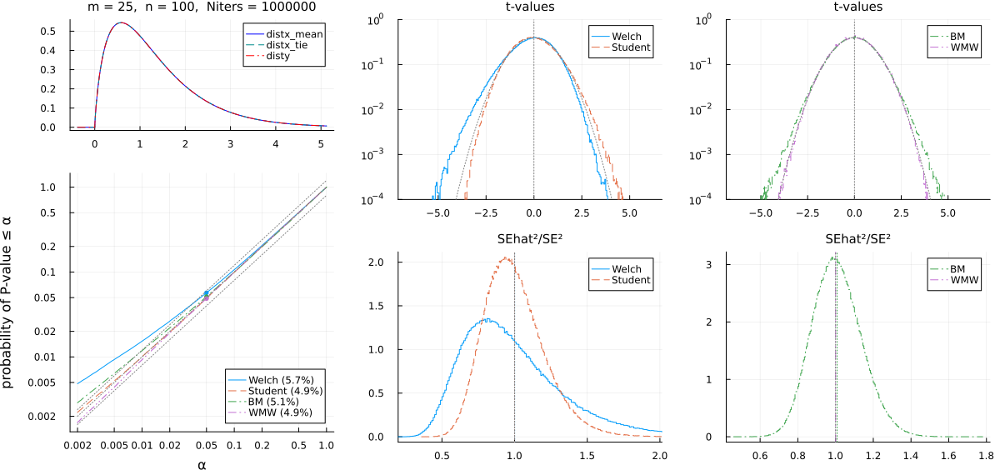

In [25]:
distx = gammadist(1, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  2.927478 seconds (41.04 M allocations: 1.354 GiB)

std(distx) = 1.2
std(disty) = 1.0
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.059132
  Student t-test:      0.077353
  Brunner-Munzel test: 0.051543
  WMW test:            0.064605



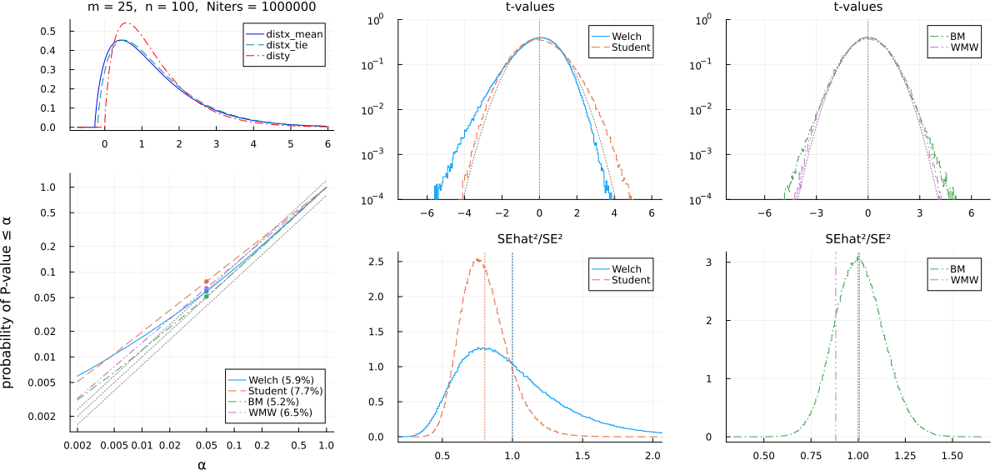

In [26]:
distx = gammadist(1.2, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  3.094459 seconds (41.16 M allocations: 1.388 GiB)

std(distx) = 1.5
std(disty) = 1.0
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.061259
  Student t-test:      0.121384
  Brunner-Munzel test: 0.051581
  WMW test:            0.084602



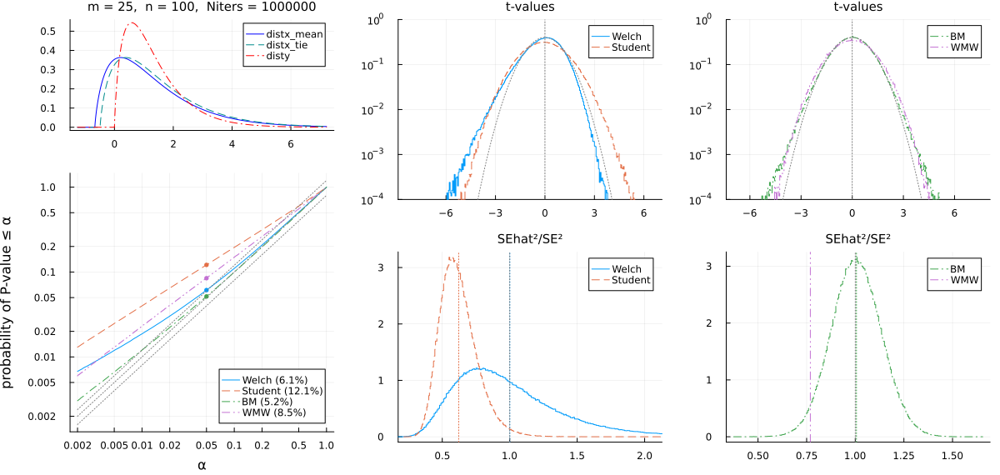

In [27]:
distx = gammadist(1.5, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  3.216223 seconds (40.82 M allocations: 1.293 GiB, 6.80% gc time)

std(distx) = 1.0
std(disty) = 1.2
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.055104
  Student t-test:      0.029303
  Brunner-Munzel test: 0.051639
  WMW test:            0.035679



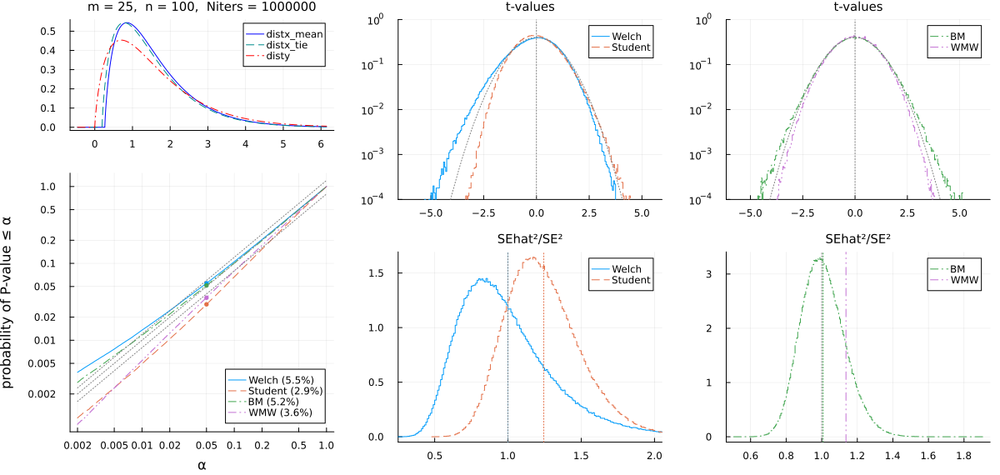

In [28]:
distx = gammadist(1, 1.5)
disty = gammadist(1.2, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  2.857146 seconds (40.71 M allocations: 1.260 GiB)

std(distx) = 1.0
std(disty) = 1.5
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.052124
  Student t-test:      0.015491
  Brunner-Munzel test: 0.051593
  WMW test:            0.024032



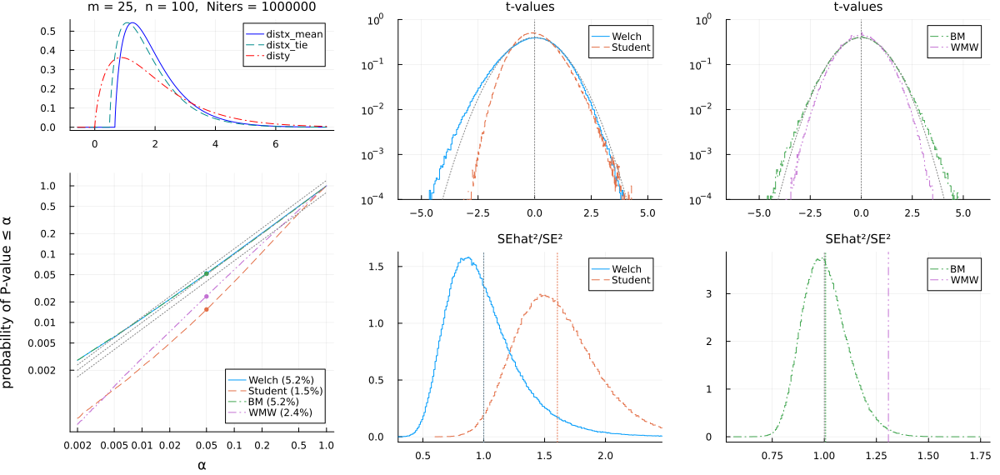

In [29]:
distx = gammadist(1, 1.5)
disty = gammadist(1.5, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  2.808926 seconds (38.40 M allocations: 2.156 GiB, 1.87% compilation time)

std(distx) = 1.0
std(disty) = 1.5
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.732407
  Student t-test:      0.584365
  Brunner-Munzel test: 0.616271
  WMW test:            0.583859



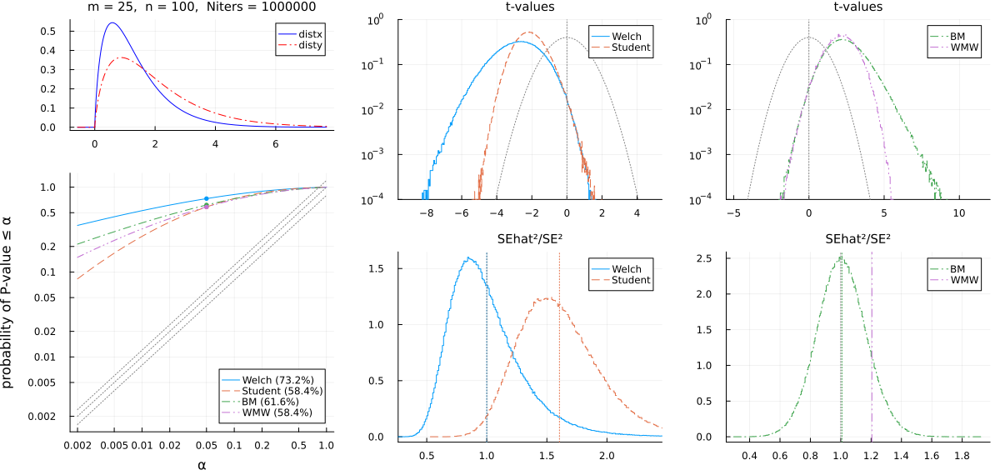

In [30]:
distx = gammadist(1, 1.5)
disty = gammadist(1.5, 1.5)
plot_sim(; distx, disty, m=25, n=100, shifttype=:none)


  8.416967 seconds (40.96 M allocations: 1.333 GiB, 2.04% gc time)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.055705
  Student t-test:      0.056119
  Brunner-Munzel test: 0.04988
  WMW test:            0.057451



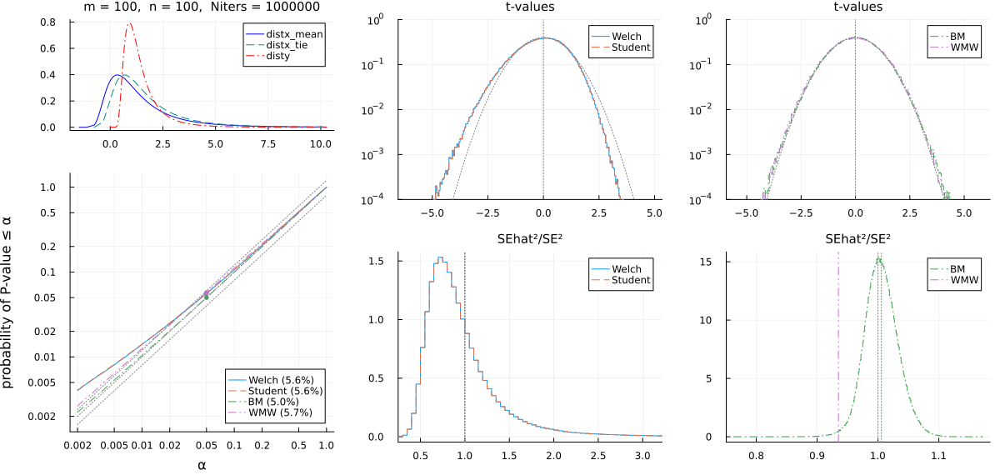

In [31]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=100, n=100)


  7.631585 seconds (41.00 M allocations: 1.342 GiB)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.057268
  Student t-test:      0.063595
  Brunner-Munzel test: 0.050468
  WMW test:            0.062021



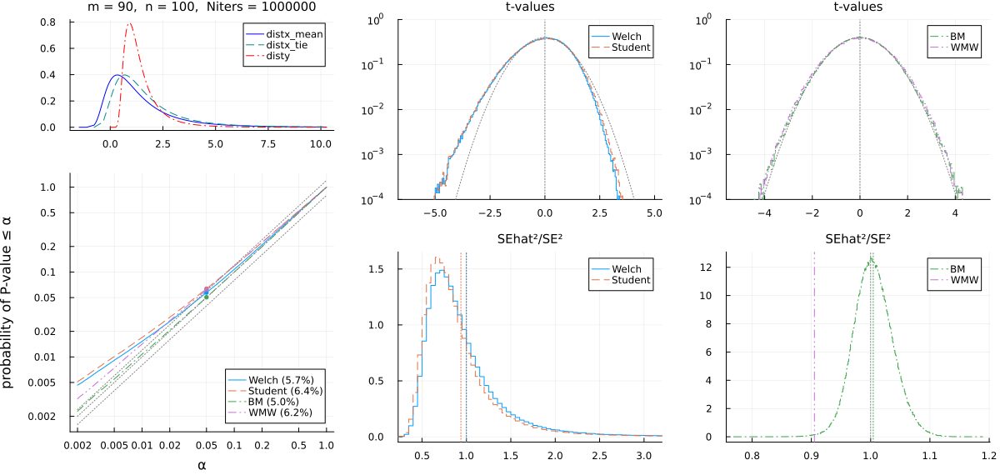

In [32]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=90, n=100)


  8.071390 seconds (41.02 M allocations: 1.349 GiB)

std(distx) = 3.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.063141
  Student t-test:      0.073148
  Brunner-Munzel test: 0.050579
  WMW test:            0.073268



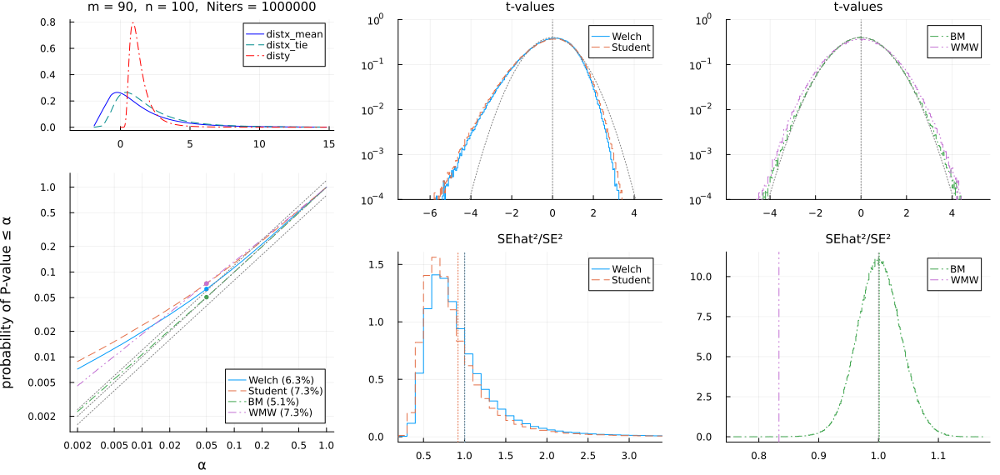

In [33]:
distx = inversegammadist(3, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=90, n=100)


 10.469877 seconds (4.09 M allocations: 137.137 MiB)

std(distx) = 3.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.0546
  Student t-test:      0.06487
  Brunner-Munzel test: 0.04957
  WMW test:            0.07316



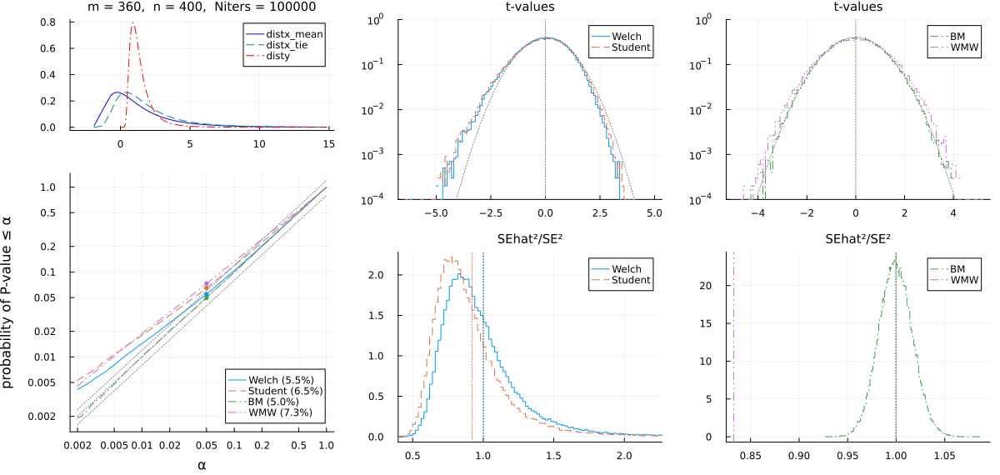

In [34]:
distx = inversegammadist(3, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=360, n=400, L=10^5)


  7.811371 seconds (41.04 M allocations: 1.355 GiB)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.058941
  Student t-test:      0.072732
  Brunner-Munzel test: 0.050607
  WMW test:            0.066516



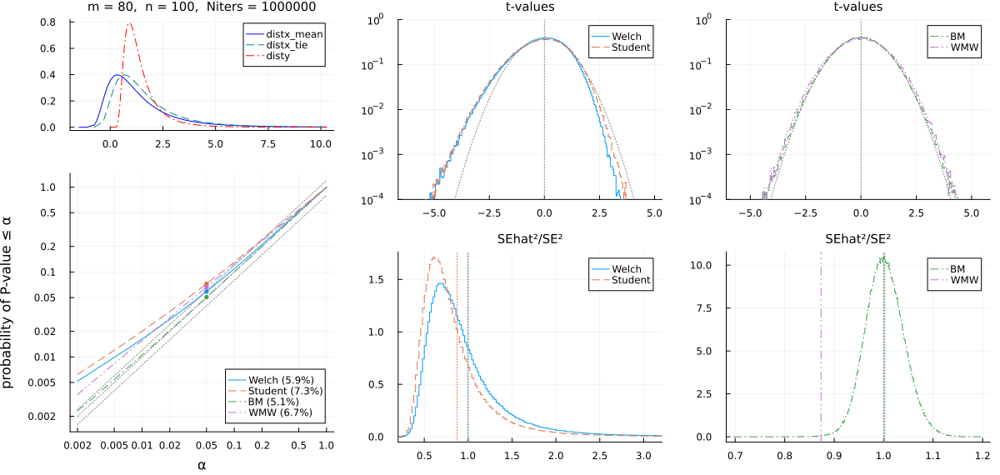

In [35]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=80, n=100)


  9.396464 seconds (4.10 M allocations: 137.748 MiB)

std(distx) = 2.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.05291
  Student t-test:      0.06825
  Brunner-Munzel test: 0.04952
  WMW test:            0.06579



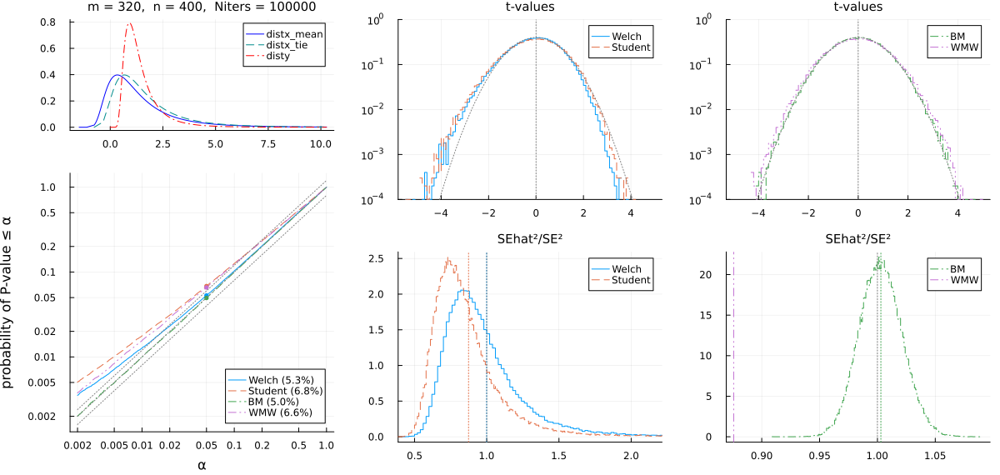

In [36]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)


  7.756052 seconds (41.07 M allocations: 1.363 GiB)

std(distx) = 3.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.064836
  Student t-test:      0.086056
  Brunner-Munzel test: 0.050129
  WMW test:            0.079132



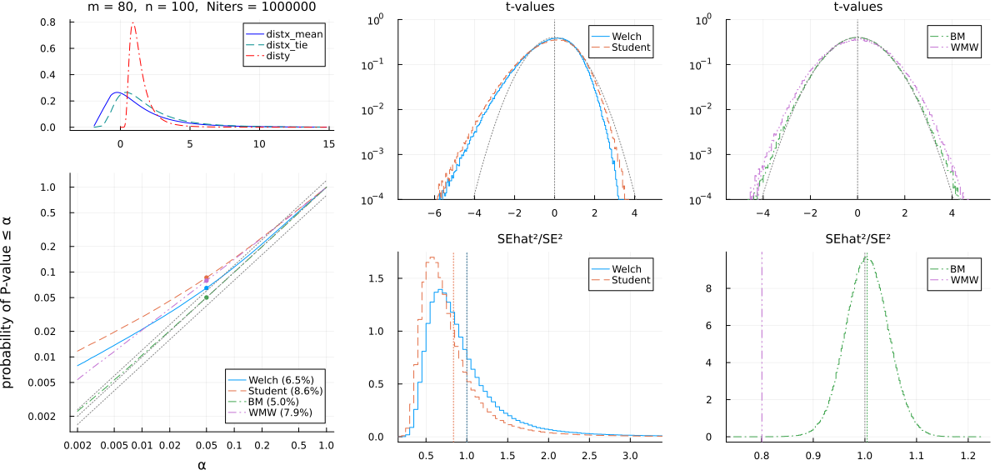

In [37]:
distx = inversegammadist(3, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=80, n=100)


 10.112162 seconds (4.10 M allocations: 138.106 MiB)

std(distx) = 3.0
std(disty) = 1.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.05436
  Student t-test:      0.07764
  Brunner-Munzel test: 0.04973
  WMW test:            0.07902



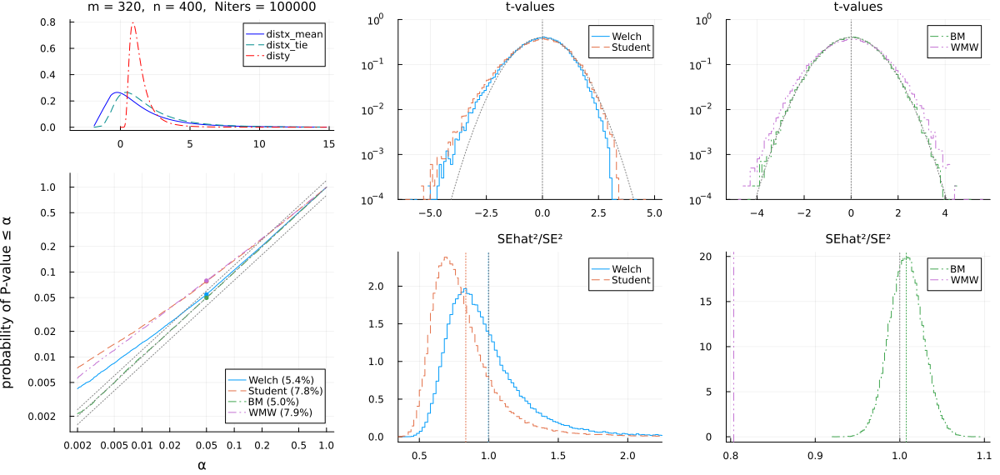

In [38]:
distx = inversegammadist(3, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)


  7.996657 seconds (40.89 M allocations: 1.312 GiB, 2.53% gc time)

std(distx) = 1.0
std(disty) = 3.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.060026
  Student t-test:      0.044894
  Brunner-Munzel test: 0.050573
  WMW test:            0.055573



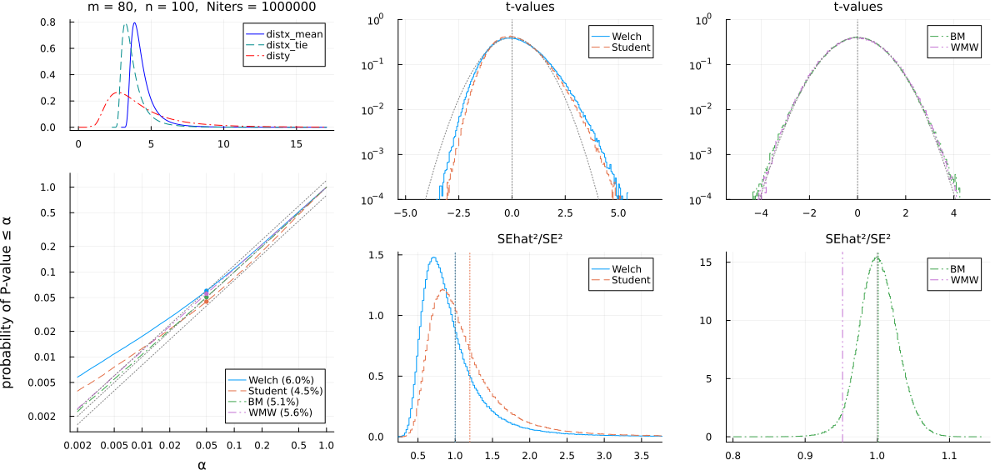

In [39]:
distx = inversegammadist(1, 5)
disty = inversegammadist(3, 5)
plot_sim(; distx, disty, m=80, n=100)


  9.401088 seconds (4.08 M allocations: 133.484 MiB)

std(distx) = 1.0
std(disty) = 3.0
skewness(distx) = 4.999999999999997
skewness(disty) = 4.999999999999997
kurtosis(distx) = 277.00266806305643
kurtosis(disty) = 277.00266806305643

true α-error rate for α = 0.05
  Welch t-test:        0.05511
  Student t-test:      0.03807
  Brunner-Munzel test: 0.04937
  WMW test:            0.0546



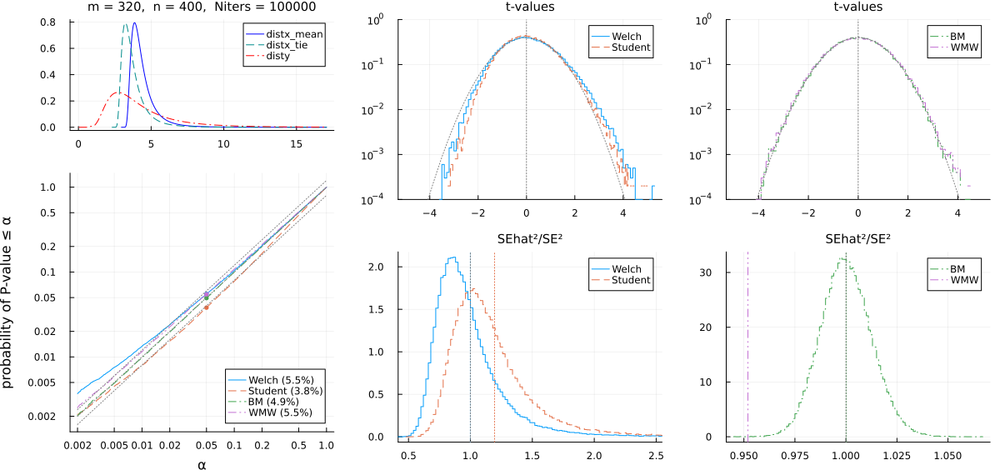

In [40]:
distx = inversegammadist(1, 5)
disty = inversegammadist(3, 5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)


  7.592080 seconds (41.02 M allocations: 1.349 GiB)

std(distx) = 3.0
std(disty) = 1.0
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.053921
  Student t-test:      0.077315
  Brunner-Munzel test: 0.05039
  WMW test:            0.082435



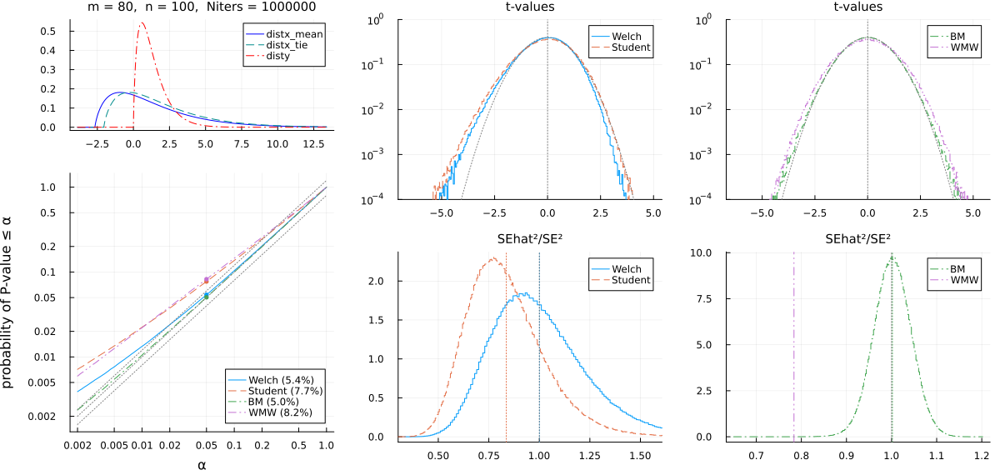

In [41]:
distx = gammadist(3, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=80, n=100)


  9.261749 seconds (4.10 M allocations: 138.031 MiB)

std(distx) = 3.0
std(disty) = 1.0
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.04961
  Student t-test:      0.07282
  Brunner-Munzel test: 0.04991
  WMW test:            0.08223



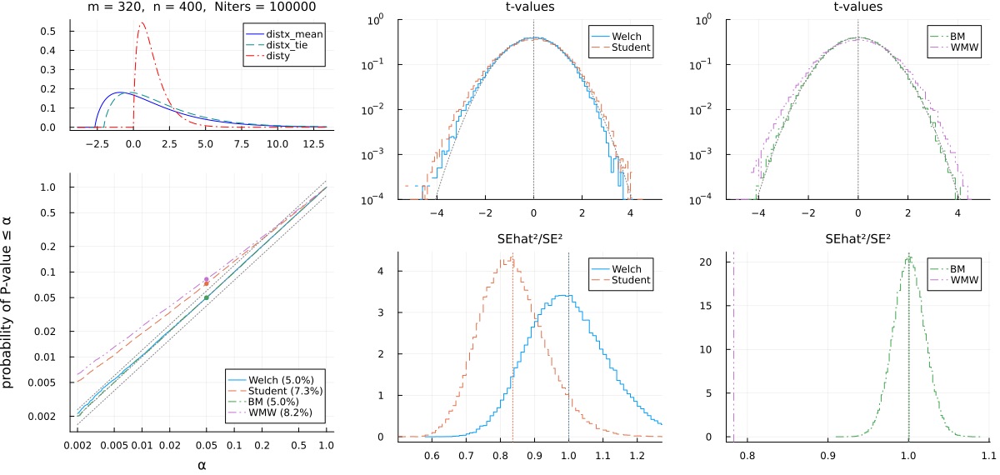

In [42]:
distx = gammadist(3, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)


  7.732762 seconds (40.84 M allocations: 1.298 GiB)

std(distx) = 1.0
std(disty) = 3.0
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.052766
  Student t-test:      0.036249
  Brunner-Munzel test: 0.050049
  WMW test:            0.056339



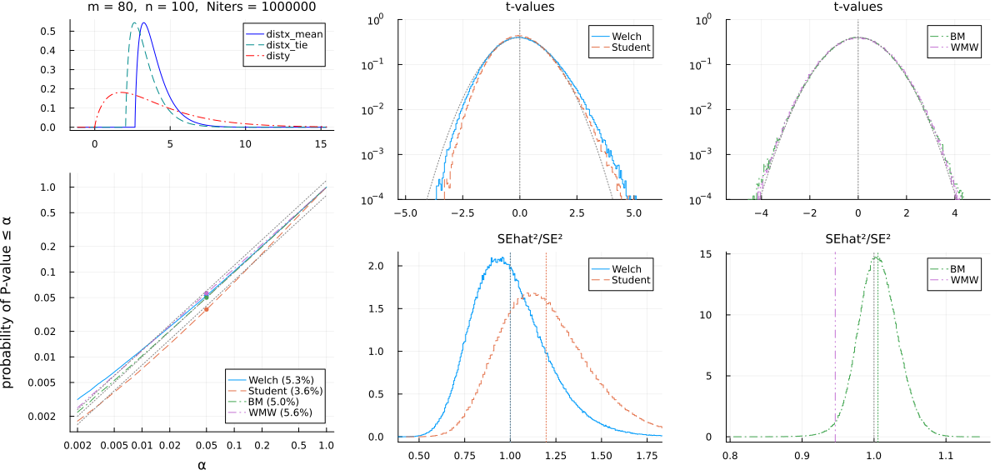

In [43]:
distx = gammadist(1, 1.5)
disty = gammadist(3, 1.5)
plot_sim(; distx, disty, m=80, n=100)


  9.316095 seconds (4.08 M allocations: 132.720 MiB)

std(distx) = 1.0
std(disty) = 3.0
skewness(distx) = 1.5
skewness(disty) = 1.5
kurtosis(distx) = 3.375
kurtosis(disty) = 3.375

true α-error rate for α = 0.05
  Welch t-test:        0.05102
  Student t-test:      0.0335
  Brunner-Munzel test: 0.0502
  WMW test:            0.05733



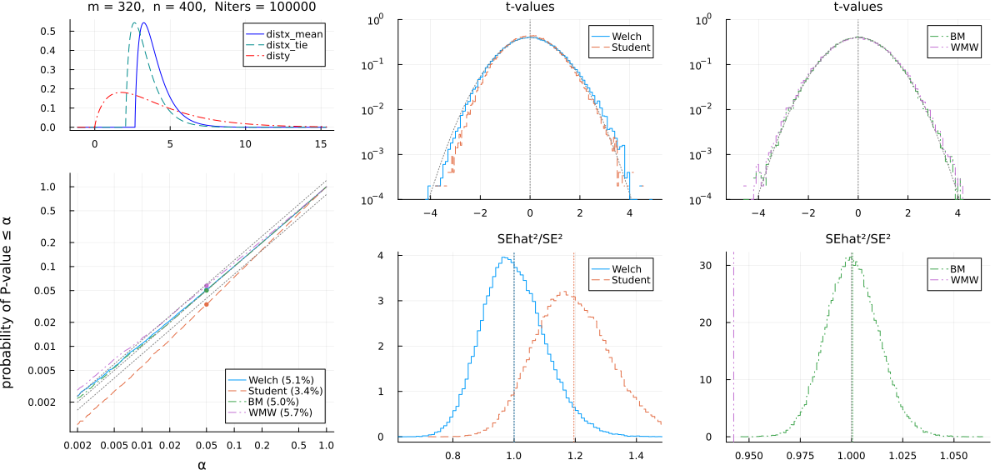

In [44]:
distx = gammadist(1, 1.5)
disty = gammadist(3, 1.5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)